# Валидация метрики для оценки разницы между сейсмограммами

In [1]:
import sys
sys.path.append('..')

from functools import reduce

import pandas as pd

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex #, seismic_plot

from utils import get_cv, draw_modifications_dist, get_modifications_list, validate_all

## Процедура получения метрики

**Расстояние между двумя спектрограммами** с равным количеством трасс и отсчетов будем вычислять по следующей процедуре

* Выбрать область из 10% трасс с наименьшим офсетом, ограничить вычисления только в этой области
* Получить спектральную плотность мощности с помощью оконного преобразования Фурье для каждой трассы для обеих спектрограмм
* Для соответствующих значений сдвигов окна по времени и соответсвующих трасс вычислить разницу спектров в разных спектрограммах по формуле
$$
Dist(A_1, A_2) = \sum_{f}\left|{A_{1}[f]-A_{2}[f]}\right|
$$
* Усреднить полученные значения по всем трассам и всем сдвигам окна по времени

![Seismogram difference metrics](Seismogram_difference_metrics.png)

## Заргузка данных

In [3]:
base_path = '/media/data/Data/datasets/multiple_lift_4_metrics_validation/QC/' #'/notebooks/data/metrics_study_ibm_outputs/4_Metrix_QC/'
      
paths = {
    'lift': '1_lift.sgy',
    'lift2': '1_lift_v1.sgy',
    'raw': '1_raw.sgy',
    'm_1': '1_1dUnet_nomask.sgy',
    'm_2': '1_1dUnet.sgy',
    'm_3': '1_ibm_unsup.sgy',
    'm_4': '1_ibm_sup.sgy',
}

In [4]:
field_index = reduce(lambda x, y: x.merge(y), 
                     (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))

In [5]:
batch = (Dataset(field_index, SeismicBatch)
         .next_batch(len(field_index))
         .load(fmt='segy', components=tuple(paths.keys())))

cv = get_cv([batch.__getattr__(c)[0] for c in batch.components])

### Количество филдов в данных

In [6]:
len(field_index)

11

### Имеющиеся компоненты

In [7]:
batch.components

('lift', 'lift2', 'raw', 'm_1', 'm_2', 'm_3', 'm_4')

## Расчет метрики отностительно LIFT

In [8]:
res = validate_all(batch)
pd.DataFrame(res).T

,LIFT,LIFT2,M_1,M_2,M_3,M_4,RAW
0,0.0,7.034503,41.110596,3.519911,69.160728,9.877405,459.439911
1,0.0,2.226749,8.961743,1.507293,8.200852,3.583091,82.446068
2,0.0,2.992579,8.342664,1.641910,11.369427,3.724335,102.378799
3,0.0,5.204864,43.747311,2.611497,68.663109,6.797871,440.219604
4,0.0,1.963246,7.398545,1.331621,8.993993,3.857164,105.988312
5,0.0,3.687569,8.963892,1.698558,16.868935,4.572943,107.621513
6,0.0,4.373885,21.410254,1.933266,51.525185,5.687918,285.642517
7,0.0,1.468070,22.466309,1.093692,16.287348,3.703800,182.215256
8,0.0,1.838491,7.748902,1.200151,27.791260,3.644614,209.240082
9,0.0,5.497565,21.370581,3.083784,32.093018,8.996897,120.418404


Field 0


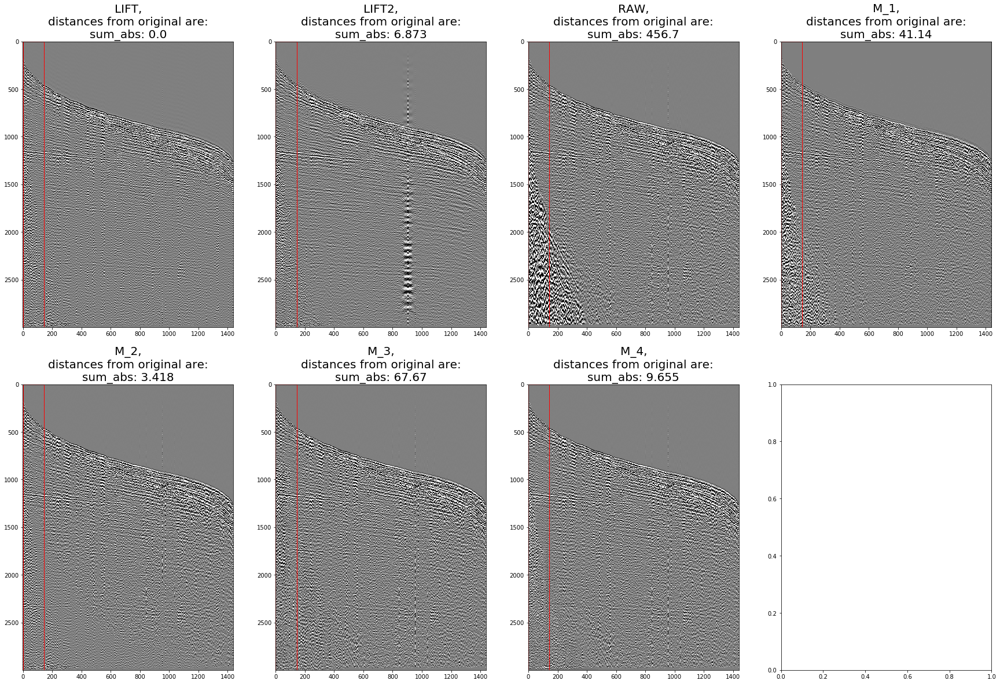

In [9]:
i=0
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 1


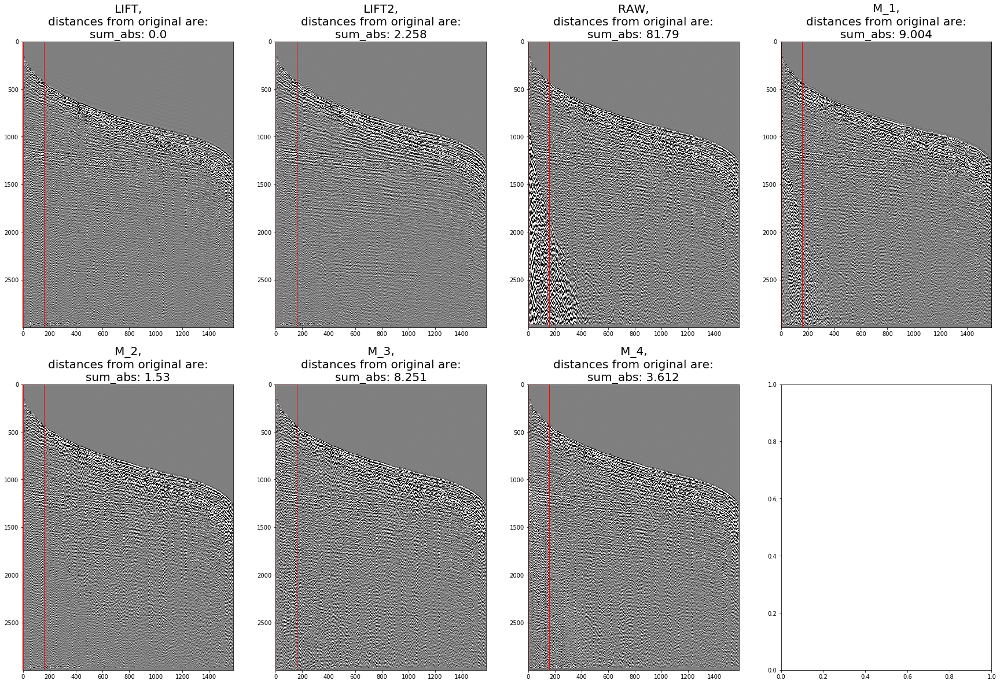

In [10]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 2


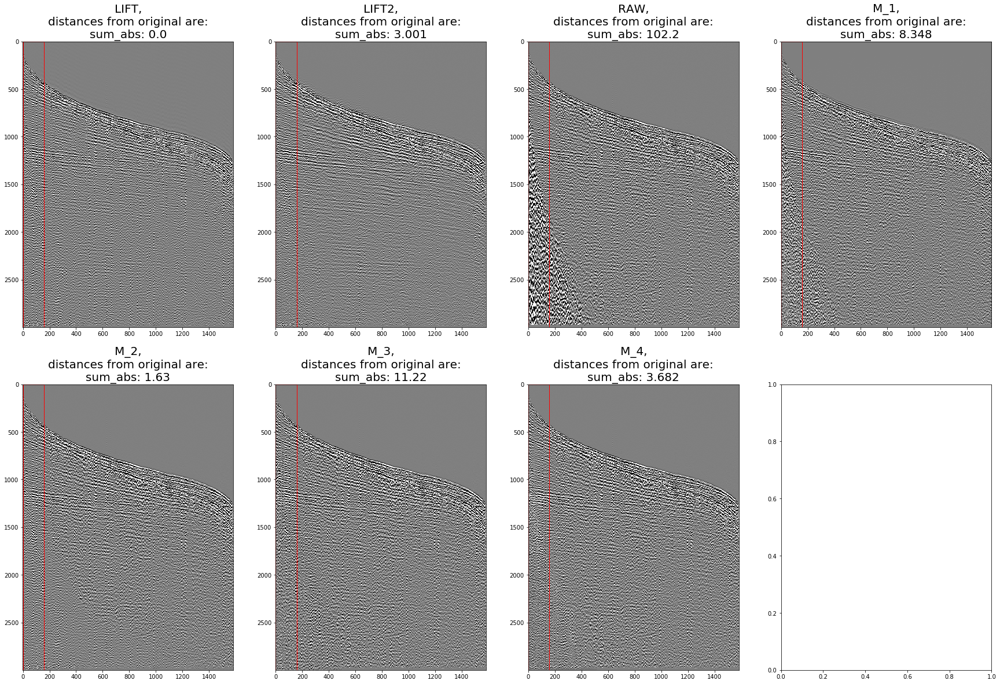

In [11]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 3


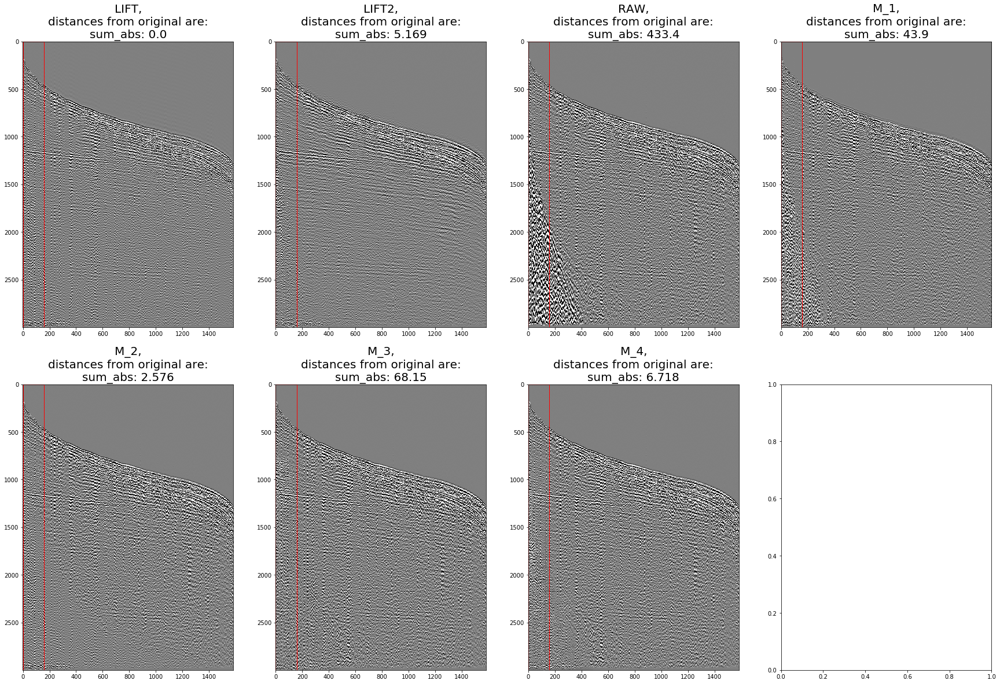

In [12]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 4


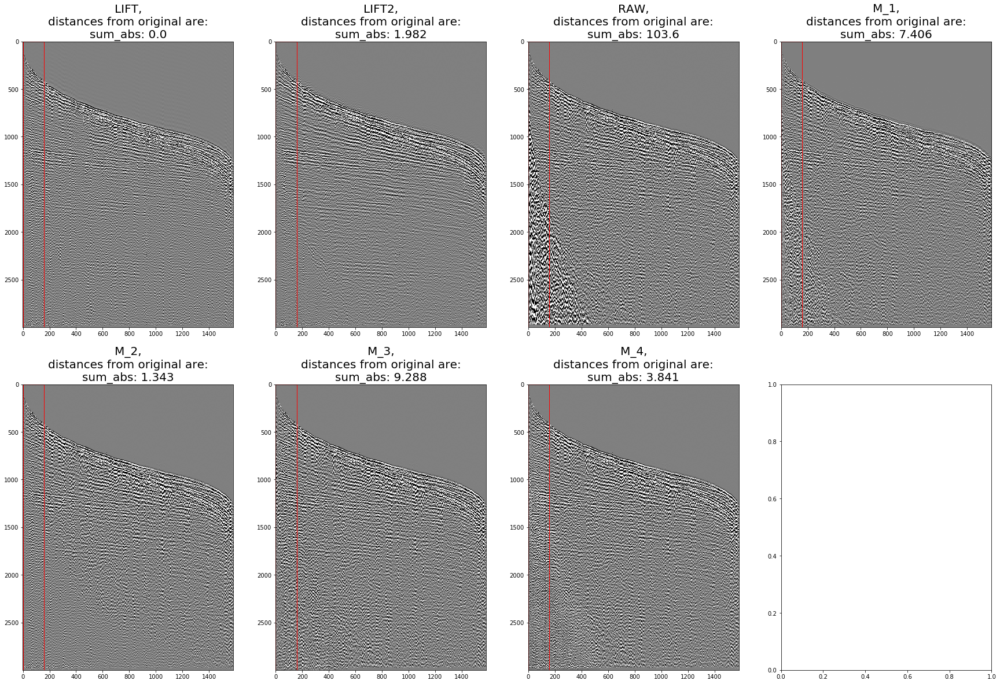

In [13]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 5


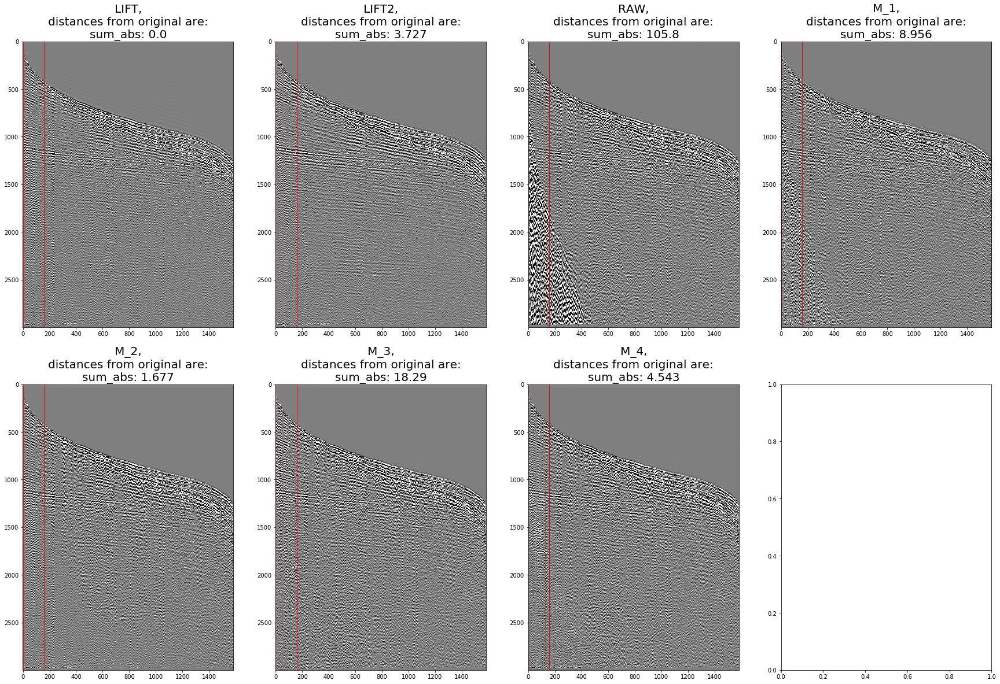

In [14]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 6


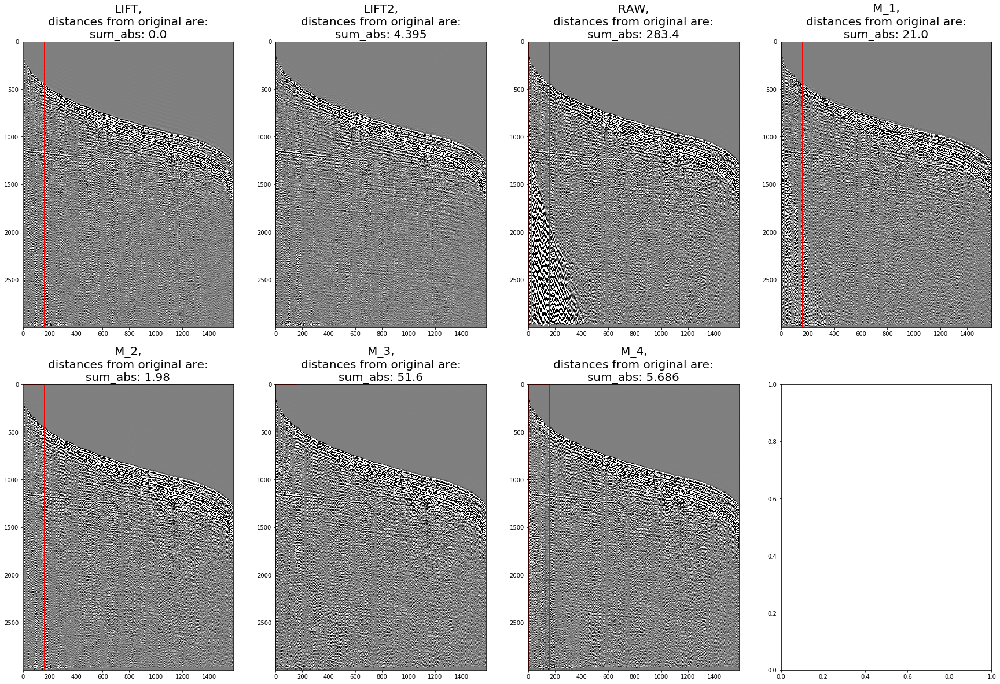

In [15]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 7


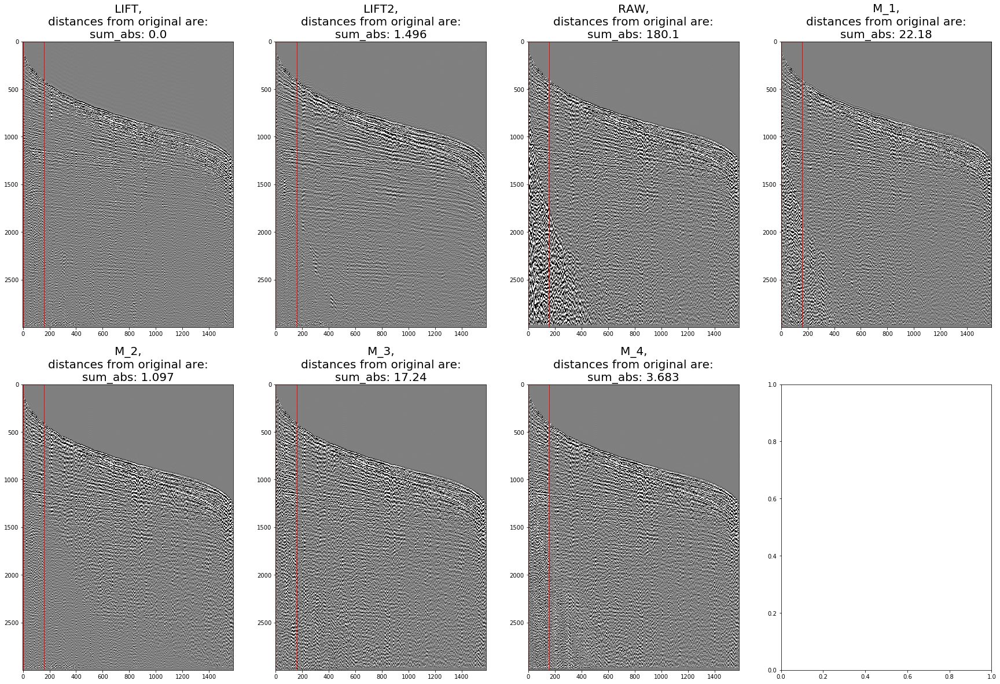

In [16]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 8


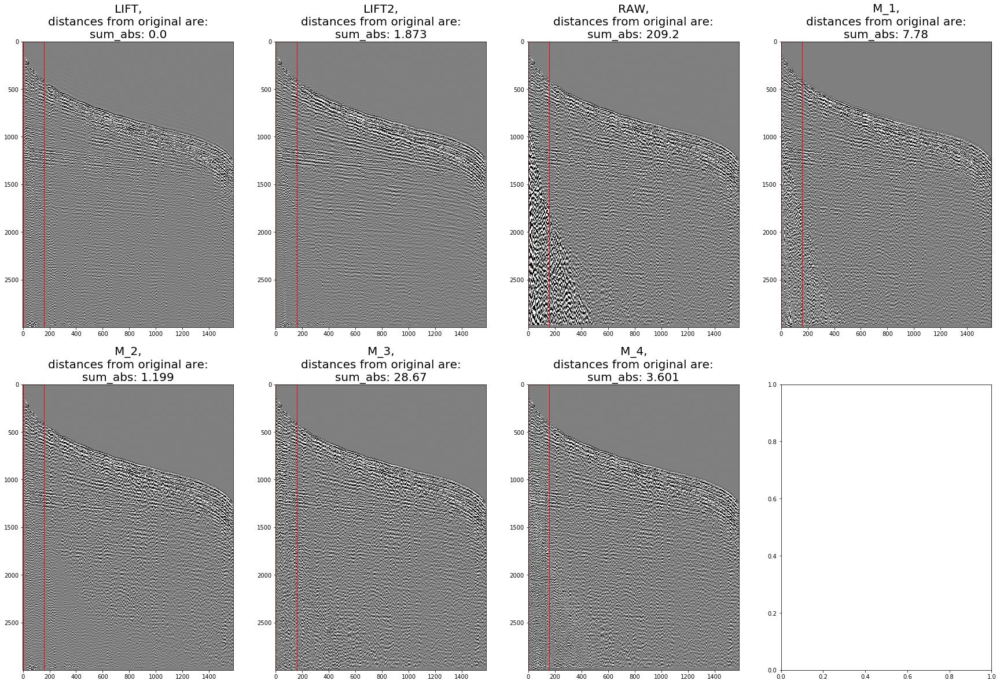

In [17]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 9


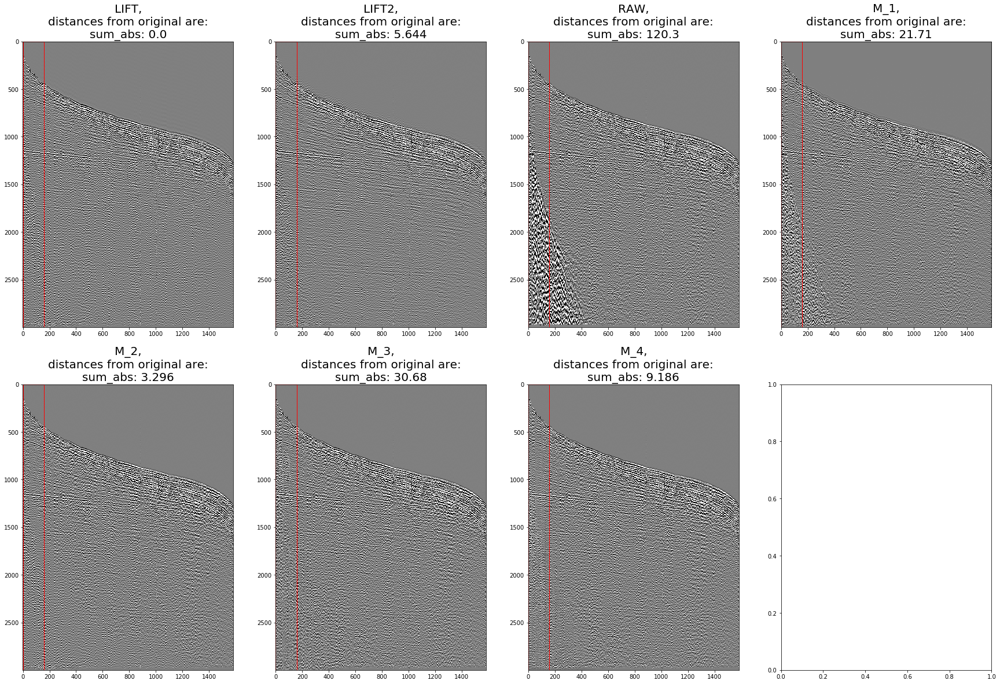

In [18]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 10


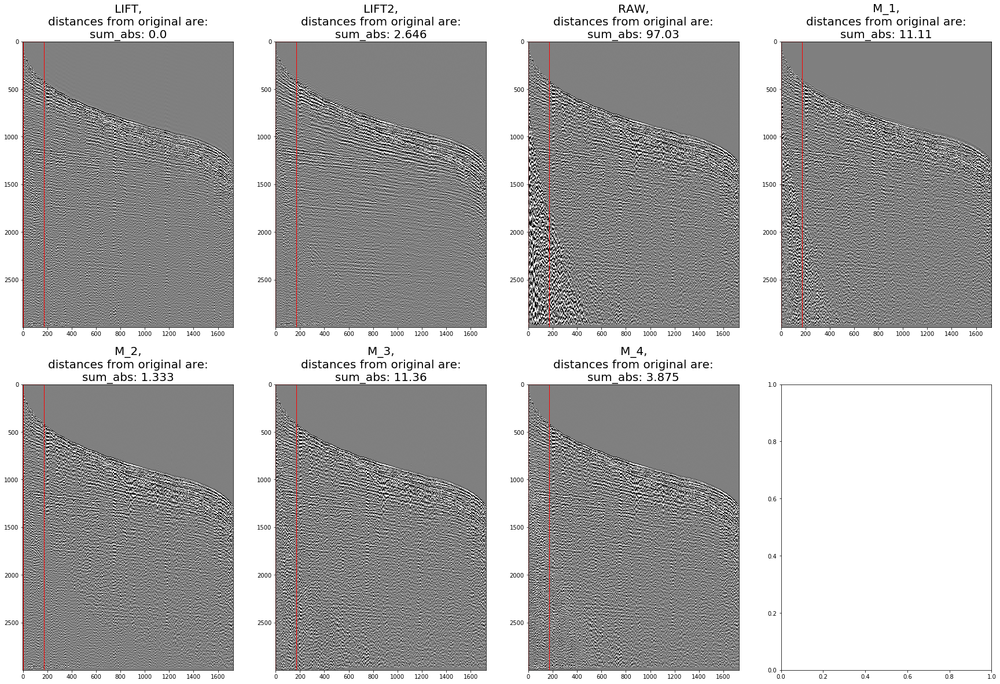

In [19]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1